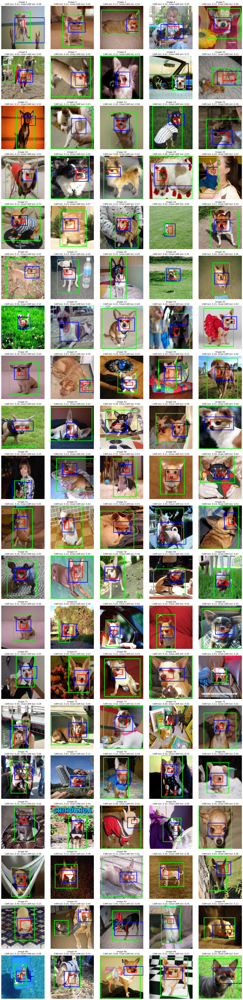

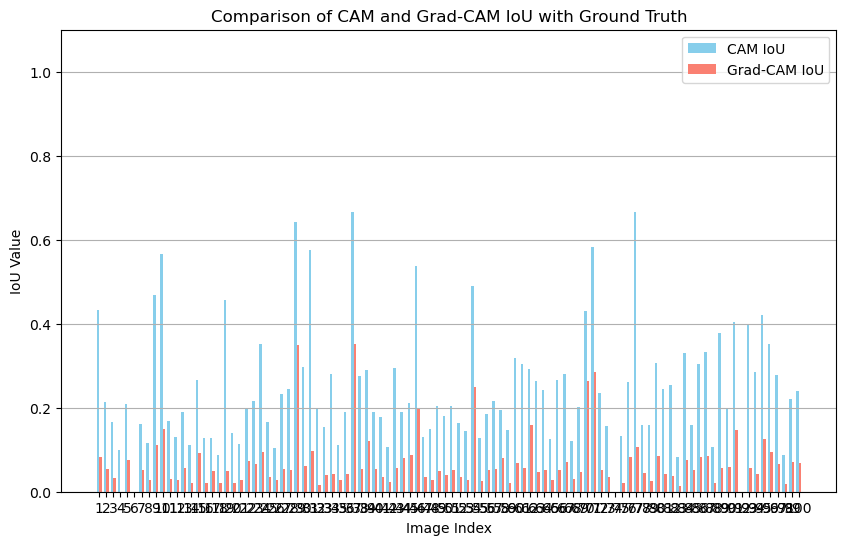

In [ ]:
# 마지막으로 100개 돌려보고 끝내자

# IoU 값을 저장할 리스트
cam_ious = []
grad_cam_ious = []

# 시각화를 위한 서브플롯 설정
fig, axes = plt.subplots(20, 5, figsize=(20, 80))
axes = axes.flatten()

# 10개의 이미지에 대해 반복
for i in range(100):
    # 1. 데이터 로드 및 전처리
    image, label, ground_bbox = train_dataset[i]
    sample_image = image.unsqueeze(0).to(device)
    orig_img = unnormalize(image)

    # 2. CAM 및 Grad-CAM 생성
    cam_image = generate_cam(model, sample_image)
    grad_cam_image = generate_grad_cam1(model, sample_image, target_layer_name="layer4")

    # 3. CAM 및 Grad-CAM에서 bbox 추출
    cam_resized = cv2.resize(cam_image, (orig_img.shape[1], orig_img.shape[0]))
    grad_cam_resized = cv2.resize(grad_cam_image, (orig_img.shape[1], orig_img.shape[0]))

    bbox_CAM = get_bbox(cam_resized, threshold=0.5)
    bbox_GradCAM = get_bbox(grad_cam_resized, threshold=0.8)

    # 4. IoU 계산 및 저장
    ground_truth = [int(x) for x in ground_bbox]
    cam_iou = get_iou(bbox_CAM, ground_truth)
    grad_cam_iou = get_iou(bbox_GradCAM, ground_truth)

    cam_ious.append(cam_iou)
    grad_cam_ious.append(grad_cam_iou)

    # 5. 시각화
    bboxes_to_draw = [
        (bbox_CAM, (0, 0, 255)),    # CAM (파란색)
        (bbox_GradCAM, (255, 0, 0)),  # Grad-CAM (빨간색)
        (ground_truth, (0, 255, 0))    # Ground Truth (초록색)
    ]
    img_with_all_bboxes = visualize_multiple_bboxes(orig_img, bboxes_to_draw)

    axes[i].imshow(img_with_all_bboxes)
    axes[i].set_title(f"Image {i+1}\nCAM IoU: {cam_iou:.2f}, Grad-CAM IoU: {grad_cam_iou:.2f}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

# ---
# 6. IoU 값 비교 그래프
plt.figure(figsize=(10, 6))
x = np.arange(100)
width = 0.35

plt.bar(x - width/2, cam_ious, width, label='CAM IoU', color='skyblue')
plt.bar(x + width/2, grad_cam_ious, width, label='Grad-CAM IoU', color='salmon')

plt.xlabel("Image Index")
plt.ylabel("IoU Value")
plt.title("Comparison of CAM and Grad-CAM IoU with Ground Truth")
plt.xticks(x, [f"{i+1}" for i in range(100)])
plt.ylim(0, 1.1)
plt.legend()
plt.grid(axis='y')
plt.show()